In [2]:
# optical flow has a problem where it cannot detect small movement properly

In [3]:
import sys
import os
sys.path.insert(0, os.path.abspath("./"))

In [4]:
from tqdm.auto import tqdm
from video_capturer import VideoCapturerProcessSpawner
from motion_vector_extractor import MotionVectorExtractorProcessSpawner
from optical_flow_generator import OpticalFlowGenerator
import plotly.express as px
import numpy

03/01/2023 14:50:56 - INFO: Note: NumExpr detected 12 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
03/01/2023 14:50:56 - INFO: NumExpr defaulting to 8 threads.


In [5]:
frames = []

In [6]:
video_path = "/mnt/c/Skripsi/dataset-h264/R002A120/S018C001P008R002A120_rgb.mp4"
args_mvex = {
    "path":  video_path,
    "bound":  32,
    "raw_motion_vectors": False,
    "camera_realtime": False,
    "camera_update_rate":  300,
    "camera_buffer_size":  0,
    "letterboxed": True,
    "new_shape": 320,
    "box": False,
    "color": (114, 114, 114, 128, 128),
    "stride":  32,
}

decoder = MotionVectorExtractorProcessSpawner(**args_mvex, update_rate=300).start()
while(True):
    data = decoder.read()
    if not data[0]:
        break
    frames.append(data)
    

Spawning and initializing motion vector extractor process...
Spawning and initializing video capturer process...
Video capturer process started
Video capturer source empty, killing process...
Motion vector extractor process started
Motion vector extractor source empty, killing process...
Stopping video capturer process...
Video capturer process stopped


In [7]:
rgbs = []
mvs = []
for _ , rgb, mv in tqdm(frames):
    rgbs.append(rgb)
    mvs.append(mv)

  0%|          | 0/100 [00:00<?, ?it/s]

In [8]:
rgbs = numpy.array(rgbs)[...,[2,1,0]]
mvs = numpy.array(mvs)

In [9]:
rgbs.shape

(100, 192, 320, 3)


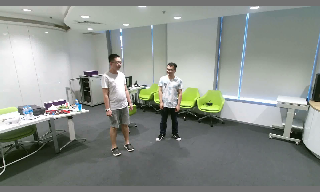
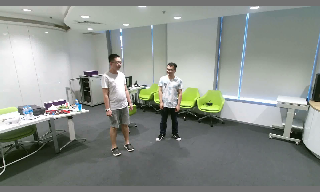
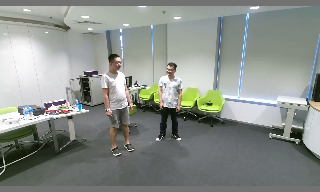
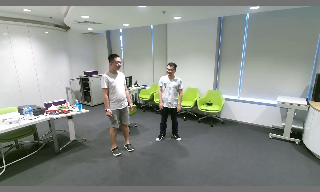
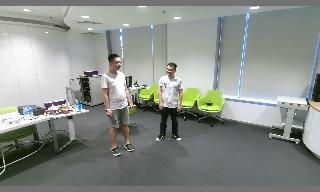
...
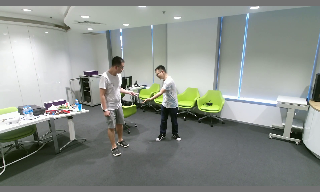
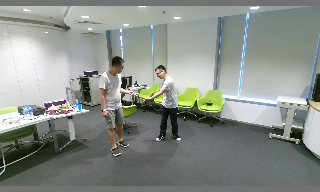
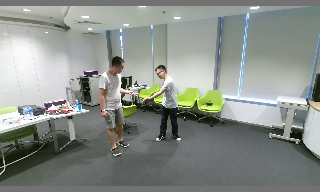
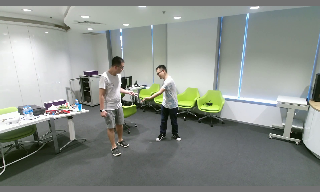
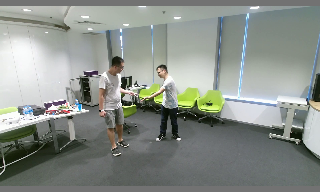

In [10]:
px.imshow(rgbs, animation_frame=0, binary_string=True)

In [11]:
mixrgb = []
for i in range(len(rgbs)-1):
    mixrgb.append((rgbs[i], rgbs[i+1]))

In [12]:
opgen = OpticalFlowGenerator("flowformer", "things", 32)

03/01/2023 14:50:59 - INFO: Created a temporary directory at /tmp/tmpfzc0v4m9
03/01/2023 14:50:59 - INFO: Writing /tmp/tmpfzc0v4m9/_remote_module_non_scriptable.py


Initializing optical flow model (flowformer -> things)...
Optical flow model (flowformer -> things) initialized


In [13]:
flform = opgen.forward(mixrgb)

Warming up optical flow model (flowformer -> things)...
|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |   64382 KB |   64383 KB |  128727 KB |   64344 KB |
|       from large pool |   34816 KB |   34816 KB |   69632 KB |   34816 KB |
|       from small pool |   29566 KB |   29567 KB |   59095 KB |   29528 KB |
|---------------------------------------------------------------------------|
| Active memory         |   64382 KB |   64383 KB |  128727 KB |   64344 KB |
|       

/home/nicholassv/anaconda3/envs/thesis_linux_3.9/lib/python3.9/site-packages/torch/functional.py:504: UserWarning:

torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)



In [14]:
flform = numpy.array(flform)


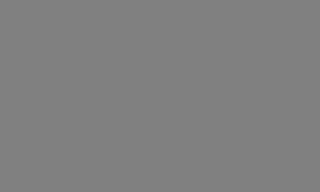
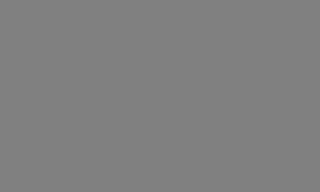
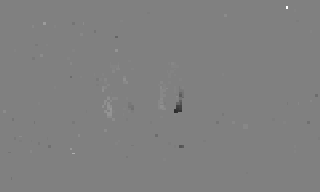
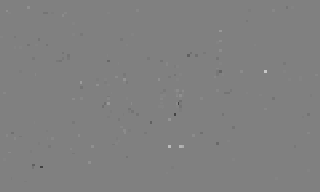
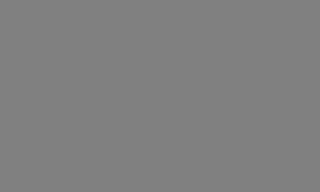
...
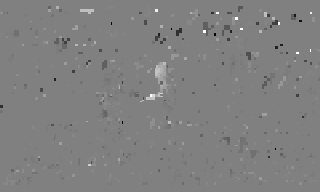
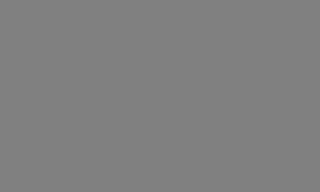
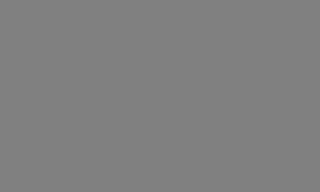
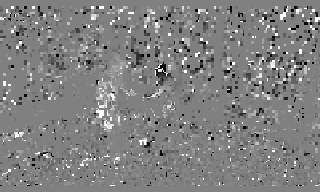
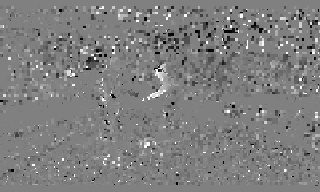

In [15]:
# optical flow almost no movement available (2 top), 
# meanwhile the motion vector (2 bottom) version is very visible
px.imshow(numpy.concatenate((flform, mvs[1:]),axis=3), facet_col=3, facet_col_wrap=2, animation_frame=0, binary_string=True)

In [16]:
# create an overlapping grid
import numba
import cv2


@numba.njit(fastmath=True, parallel=True)
def generate_overlap_grid_core(
    image_list: ndarray,
    scale: int = 4
) -> tuple[list[ndarray], int, int]:
    image_h, image_w = image_list.shape[1:3]
    h_shift: int = (image_h//scale) // 2
    w_shift: int = (image_w//scale) // 2

    # unshifted
    vertical_split_unshifted: list[ndarray] = numpy.split(image_list, (scale), axis=1)
    unshifted: list[ndarray] = []
    for i in numba.prange(scale):
        horizontal_split_unshifted: list[ndarray] = numpy.split(vertical_split_unshifted[i], (scale), axis=2)
        for j in numba.prange(scale):
            unshifted.append(horizontal_split_unshifted[j])

    # shifted
    image_shifted: ndarray = image_list[:, h_shift:-h_shift, w_shift:-w_shift]

    vertical_split_shifted: list[ndarray] = numpy.split(image_shifted, (scale-1), axis=1)
    shifted: list[ndarray] = []
    for i in numba.prange(scale-1):
        horizontal_split_shifted: list[ndarray] = numpy.split(vertical_split_shifted[i], (scale-1), axis=2)
        for j in numba.prange(scale-1):
            shifted.append(horizontal_split_shifted[j])

    unshifted.extend(shifted)

    return unshifted, image_h, image_w


def generate_overlap_grid(
    image_list: ndarray,
    scale: int = 4
) -> ndarray:

    grids, image_h, image_w = generate_overlap_grid_core(image_list, scale)

    scaled: list[list[ndarray]] = []
    for img_tuple in grids:
        resized_img_tuple = [
            cv2.resize(img, (image_w, image_h), interpolation=cv2.INTER_NEAREST)
            for img in img_tuple
        ]
        scaled.append(resized_img_tuple)

    return numpy.array(scaled)


@numba.njit(fastmath=True, parallel=True)
def reconstruct_overlap_grid_core(
    resized_overlap_grid: ndarray,
    overlap_grid_shape: tuple[int, ...],
    scale: int = 4
) -> ndarray:
    grid_n, image_n, image_h, image_w, image_c = overlap_grid_shape
    grid_h: int = image_h // scale
    grid_w: int = image_w // scale
    h_shift: int = grid_h // 2
    w_shift: int = grid_w // 2

    # recreate base image
    base_image: ndarray = numpy.zeros((image_n, image_h, image_w, image_c), dtype=resized_overlap_grid.dtype)

    for i in numba.prange(grid_n):
        if i < scale ** 2:
            # if reading unshifted apply normally
            x_sta: int = (i % scale) * grid_w
            y_sta: int = (i // scale) * grid_h
            x_end: int = x_sta + grid_w
            y_end: int = y_sta + grid_h
            base_image[:, y_sta:y_end, x_sta:x_end] = resized_overlap_grid[i]
        else:
            # if reading shifted, replace if absolute value is bigger
            i_sh: int = i - scale**2
            x_sta: int = (i_sh % (scale-1)) * grid_w + w_shift
            y_sta: int = (i_sh // (scale-1)) * grid_h + h_shift

            for y_off in numba.prange(grid_h):
                y_tar: int = y_sta + y_off
                for x_off in numba.prange(grid_w):
                    x_tar: int = x_sta + x_off
                    for img_n in numba.prange(image_n):
                        for chan_n in numba.prange(image_c):
                            curr_val = base_image[img_n, y_tar, x_tar, chan_n]
                            targ_val = resized_overlap_grid[i, img_n, y_off, x_off, chan_n]

                            if abs(targ_val) > abs(curr_val):
                                base_image[img_n, y_tar, x_tar, chan_n] = targ_val

    return base_image


def reconstruct_overlap_grid(
    overlap_grid: ndarray,
    scale: int = 4
):
    _, _, image_h, image_w, _ = overlap_grid.shape
    grid_h: int = image_h // scale
    grid_w: int = image_w // scale

    resized_overlap_grid: list[list[ndarray]] = []
    for img_tuple in overlap_grid:
        resized_img_tuple = [
            cv2.resize(x, (grid_w, grid_h), interpolation=cv2.INTER_NEAREST)
            for x in img_tuple
        ]
        resized_overlap_grid.append(resized_img_tuple)

    return reconstruct_overlap_grid_core(numpy.array(resized_overlap_grid), overlap_grid.shape, scale)


In [17]:
ov_gri = generate_overlap_grid(rgbs[0:2])

In [18]:
ov_gri.shape

(25, 2, 192, 320, 3)


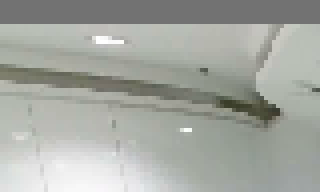
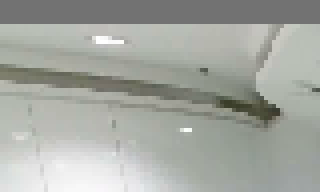
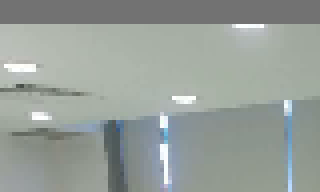
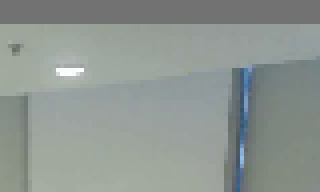
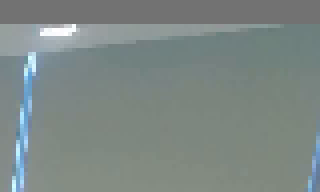
...
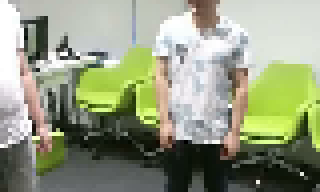
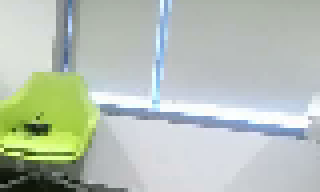
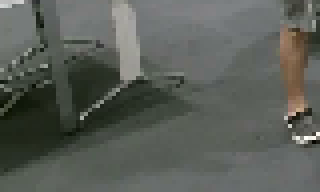
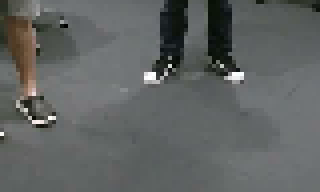
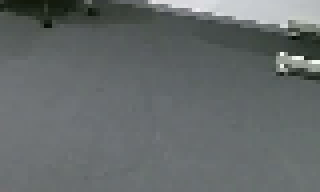

In [19]:
px.imshow(numpy.array(ov_gri)[:,0],animation_frame=0, binary_string=True)

In [20]:
imgs_rec = reconstruct_overlap_grid(ov_gri)


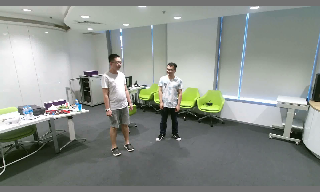
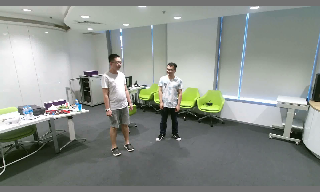
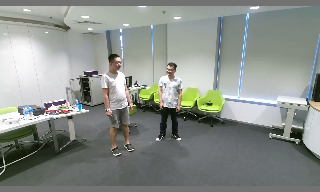

In [21]:
px.imshow(imgs_rec, animation_frame=0, binary_string=True)

In [22]:
numpy.array(mixrgb).shape

(99, 2, 192, 320, 3)

In [24]:
# using reconstruct grid applying motion flow
rec_flo = []
for img_pair in tqdm(mixrgb):
    ov_gri_rg = generate_overlap_grid(numpy.array(img_pair),2)
    flform_ovgri = opgen.forward(ov_gri_rg)
    flform_opt = numpy.array(flform_ovgri)[:,None,...]
    flform_rec = reconstruct_overlap_grid(flform_opt,2)
    rec_flo.append(flform_rec[-1,...])

  0%|          | 0/99 [00:00<?, ?it/s]


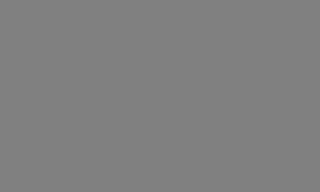
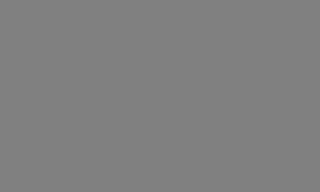
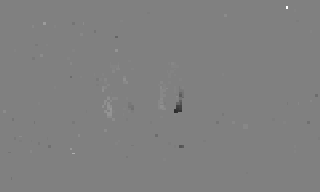
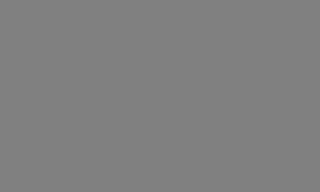
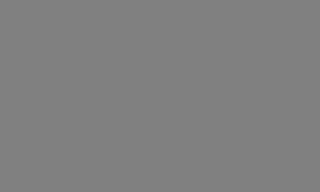
...
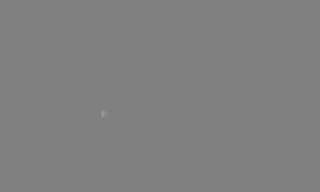
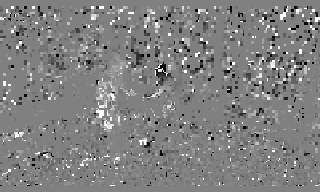
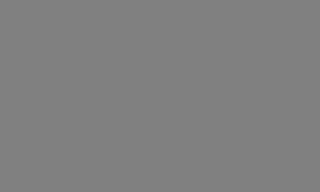
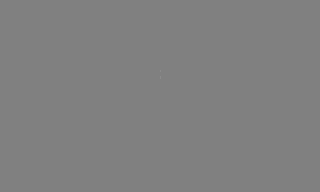
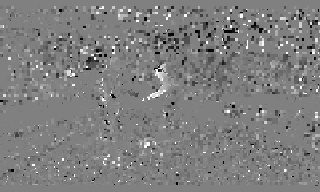

In [25]:
px.imshow(numpy.concatenate((flform, rec_flo, mvs[1:]),axis=3)[...,[0,2,4,1,3,5]], facet_col=3, facet_col_wrap=3, animation_frame=0, binary_string=True)